# Do Koreans own in Koreatown?

In [2]:
import pandas as pd
import geopandas as gpd
import fiona

/Users/mhustiles/.local/share/virtualenvs/notebooks-xu8v5Vvv/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  warnings.warn(


### Read parcels shapefile

In [49]:
parcels = gpd.read_file('/Users/mhustiles/data/gis/parcels/parcels_slim/parcels_slimmer.shp')

In [ ]:
parcels_df = parcels.to_crs(epsg=4326)

In [ ]:
parcels_df.crs

In [42]:
len(parcels_df)

2415954

---

### Read parcels metadata

In [43]:
meta_df = pd.read_csv('output/catholic_parcels_lacounty.csv')

In [44]:
meta_df = meta_df.astype(str)

In [45]:
meta_df.head()

,assessor_identification_number,taxrate_area,administrative_region_number,common_area_key,year_sold_to_state,recording_date,land_value,improvement_value,gross_personal_property_key,filler,...,legal_description_line_four,legal_description_line_five,zoning_code,use_code,effective_year,year_built,building_-_square_feet_-_main,usecode,usetype,usedescription
0,7416020037,400,26.0,0,0,19670145,144200,661934,4,0,...,nan,nan,LARD1.5,7200,0,0,0,7200,Institutional,Schools (Private)
1,7416020038,400,26.0,0,0,19660000,246818,3951,Ã¿,0,...,nan,nan,LAC2,2700,1963,1963,5000,2700,Commercial,Parking Lots (Commercial Use Properties)
2,7416024023,400,26.0,0,0,19670145,64521,110735,4,0,...,nan,nan,LARD2,7100,1951,1951,6030,7100,Institutional,Churches
3,7420026002,400,26.0,0,0,19661011,16732,1324,Ã¿,0,...,nan,nan,LAR1,2700,1966,1966,5600,2700,Commercial,Parking Lots (Commercial Use Properties)
4,7420026003,400,26.0,0,0,19670145,16732,1776,Ã¿,0,...,nan,nan,LAR1,2700,1966,1966,5600,2700,Commercial,Parking Lots (Commercial Use Properties)


---

### Merge with boundaries

In [46]:
merged_df = pd.merge(parcels_df, meta_df, left_on='AIN', right_on='assessor_identification_number')

In [47]:
len(merged_df)

1484

In [48]:
merged_df.to_file('output/catholic_properties.geojson', driver='GeoJSON')

In [ ]:
!mapshaper -i output/catholic_properties.geojson \
-o output/catholic_properties_mapshaper.geojson \

### Parcels simplified, filtered to `residential` and dissolved to `usecode`

In [ ]:
!mapshaper -i input/koreatown-parcels.geojson \
-simplify percentage=.5 no-repair \
-filter 'usetype == "Residential"' \
-dissolve 'usecode' \
-o output/koreatown-parcels-processed.geojson \

[filter] Retained 6,862 of 7,817 features
[dissolve] Dissolved 6,862 features into 45 features
[o] Wrote output/koreatown-parcels-processed.geojson


In [ ]:
parcels_new = gpd.read_file('output/koreatown-parcels-processed.geojson')

### Plot the slimmed parcels

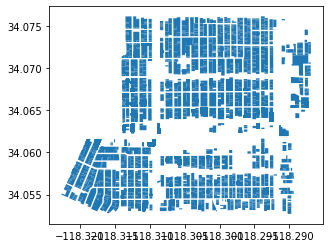

In [ ]:
parcels_new.plot()

### Buildings plot

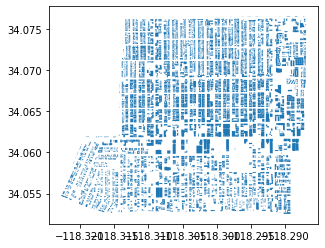

In [ ]:
buildings.plot()

## What types of businesses are here? 

In [ ]:
parcels.groupby(['usetype']).size()

usetype
Commercial        787
Government         46
Industrial         29
Institutional      81
Miscellaneous       2
Recreational        8
Residential      6862
dtype: int64

In [ ]:
commercial = parcels[parcels['usetype'] == 'Commercial']

In [ ]:
parcels.groupby('usetype').size()

usetype
Commercial        787
Government         46
Industrial         29
Institutional      81
Miscellaneous       2
Recreational        8
Residential      6862
dtype: int64

In [ ]:
usedescriptions = parcels.groupby('usedescription')

In [ ]:
usetypes = parcels.groupby('usetype')

In [ ]:
usedescriptions['usedescription'].agg(np.size).sort_values(ascending=False)

usedescription
Single                                                           4562
Five or more apartments                                          1652
Four Units (Any Combination)                                      374
Two Units                                                         197
Parking Lots (Commercial Use Properties)                          169
Office Buildings                                                  146
Stores                                                            121
Store Combination                                                 120
Three Units (Any Combination)                                      62
Government Parcel                                                  46
Restaurants, Cocktail Lounges                                      45
Shopping Centers (Neighborhood, community)                         41
Auto, Recreation EQPT, Construction EQPT, Sales & Service          39
Churches                                                           37
Hotel

In [ ]:
all_owned = usetypes['usetype'].agg(np.size)

### [Top 50 korean surnames](http://citeseerx.ist.psu.edu/viewdoc/download?doi=10.1.1.867.5053&rep=rep1&type=pdf)

In [ ]:
korean_surnames = list(map(lambda x:x.upper(),['Kim,', 'Lee,', 'Park,', 'Choi,', 'Chung,', 'Cho,', 'Kang,', 'Chang,', 'Shin,', 'Yoon,', 'Han,', 'Oh,', 'Hong,', 'Song,', 'Kwon,', 'Yoo,', 'Ahn,', 'Hwang,', 'Rhee,', 'Lim,'
'Suh,', 'Yang,', 'Moon,', 'Chun,', 'Ko,', 'Pak,', 'Choe,', 'Yi,', 'Jung,', 'Min,'
'Yu,', 'Yun,', 'Hahn,', 'Nam,', 'Cha,', 'Paik,', 'Ha,', 'Son,', 'Bae,', 'Koh,'
'Kwak,', 'Shim,', 'Yim,', 'Jang,', 'Ryu,', 'Huh,', 'Im,', 'Sohn,', 'Sung,', 'Jun,']))

### Are there Korean surnames on the parcels list?

In [ ]:
parcels['is_korean'] = 'Non-Korean'

In [ ]:
parcels.loc[parcels.ownername.str.contains('|'.join(korean_surnames ),na=False), 'is_korean'] = 'Korean'

In [ ]:
parcels.sort_values('is_korean', ascending=True).head()

,ain,ownername,objectid,situsdirection,situsunit,situsaddress,situscity,situszip,qualityclass1,yearbuilt1,...,usedescription,roll_year,roll_landvalue,roll_impvalue,roll_impbaseyear,ownerfullname,center_lat,center_lon,geometry,is_korean
4655,5093011007,"MASON,HOMER AND EDERLINDA S TRS",688229,S,,715 S SERRANO AVE,LOS ANGELES CA,90005-2804,D75A,1916,...,Single,2019,168327.0,190.0,1975,"MASON,HOMER AND EDERLINDA S TRS MASON TRUST",34.059190,-118.306957,"POLYGON ((-118.30672 34.05909, -118.30672 34.0...",Korean
2077,5092007062,"LEE,HYUN G AND",619996,S,111,681 S NORTON AVE 111,LOS ANGELES CA,90005-3877,D8D,2003,...,Single,2019,442522.0,353382.0,2016,"LEE,HYUN G AND CHEONG,SYLVIA S",34.060735,-118.317567,"POLYGON ((-118.31722 34.06100, -118.31760 34.0...",Korean
6403,5503024132,"YI,ZHOU",1520777,S,259,525 S ARDMORE AVE 259,LOS ANGELES CA,90020-3306,D7B,1973,...,Single,2019,105000.0,160000.0,2019,"YI,ZHOU",34.064864,-118.302098,"POLYGON ((-118.30174 34.06525, -118.30174 34.0...",Korean
5168,5094021044,"PARK,EUN JU",695684,S,202,908 S ARDMORE AVENUE 202,LOS ANGELES CA,90006,D9B,2008,...,Single,2019,278683.0,331212.0,2014,"PARK,EUN JU",34.055391,-118.301652,"POLYGON ((-118.30144 34.05551, -118.30144 34.0...",Korean
2080,5502024103,"KIM,SAE D AND PENNY Y",620006,W,NO 906,3223 W 6TH ST NO 906,LOS ANGELES CA,90020-5010,AX,2009,...,Single,2019,344548.0,298609.0,2011,"KIM,SAE D AND PENNY Y",34.064219,-118.292560,"POLYGON ((-118.29234 34.06475, -118.29234 34.0...",Korean


In [ ]:
korean_owners = parcels[parcels.is_korean == 'Korean']

In [ ]:
usetypes_koreans = korean_owners.groupby('usetype')

In [ ]:
usetypes_koreans

In [ ]:
korean_owned = usetypes_koreans['usetype'].agg(np.size)

### What share of each usetype is owned by Korean surname?

In [26]:
((korean_owned / all_owned)*100).round(1).sort_values(ascending=False)

usetype
Residential      37.5
Commercial       14.7
Institutional    11.1
Industrial        3.4
Government        NaN
Miscellaneous     NaN
Recreational      NaN
Name: usetype, dtype: float64

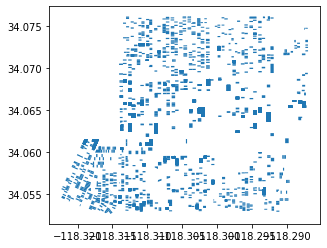

In [27]:
korean_owners.plot()

### Merge parcels to buildings, add 'ownername' and 'usetype' to buildings

In [28]:
trimmed_parcels = parcels[[
    'ain',
    'ownername',
    'geometry',
    'is_korean'
]]

In [29]:
merged = parcels.merge(buildings, on='ain')

In [30]:
merged_spatial = gpd.sjoin(trimmed_parcels, buildings, how="right", op='intersects').reset_index()

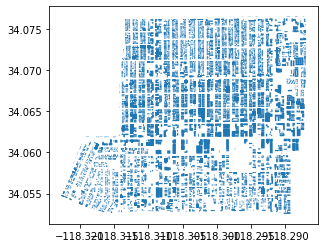

In [31]:
merged_spatial.plot()

In [32]:
merged_spatial = merged_spatial[pd.notnull(merged_spatial.is_korean)]

In [33]:
merged_spatial.groupby(['is_korean']).size()

is_korean
Korean         5382
Non-Korean    10522
dtype: int64

### Attribute join

In [34]:
merged = parcels.merge(buildings, on='ain')

In [35]:
len(merged)

5489

In [36]:
merged.columns

Index(['ain', 'ownername', 'objectid', 'situsdirection', 'situsunit',
       'situsaddress', 'situscity', 'situszip', 'qualityclass1', 'yearbuilt1',
       'units1', 'bedrooms1', 'bathrooms1', 'sqftmain1', 'recdate',
       'lastsaleamount', 'lastsaledate', 'parcelcreatedate', 'taxratearea',
       'usecode', 'usecode_2', 'usetype', 'usedescription', 'roll_year',
       'roll_landvalue', 'roll_impvalue', 'roll_impbaseyear', 'ownerfullname',
       'center_lat', 'center_lon', 'geometry_x', 'is_korean', 'ogc_fid',
       'code', 'bld_id', 'height', 'elev', 'area', 'source', 'date_',
       'shape_leng', 'shape_area', 'geometry_y'],
      dtype='object')

### Set dataframe as geoJSON for Altair map

In [37]:
geojson = json.loads(merged_spatial.to_json())

In [38]:
features = alt.Data(values=geojson['features'])

### Plot the work so far

In [39]:
base = alt.Chart(features).mark_geoshape(
    stroke='white',
    strokeWidth=0
).encode().properties(
    width=700,
    height=500
)

In [40]:
geoshape = alt.Chart(features).mark_geoshape(
    fill='lightgray',
    stroke='white',
    strokeWidth=.1
)

In [41]:
residents = geoshape.encode(
    color=alt.Color(
        "properties.is_korean:N",
        title="Owner w/ Korean surname"
    ),
)

usetype = geoshape.encode(
    color=alt.Color(
        "properties.usetype:N",
        title="Use type"
    ),
)

In [42]:
(base + residents).properties(title="Buildings in L.A. Koreatown").configure_view(
    strokeWidth=0
)

alt.LayerChart(...)